In [ ]:
#ncf denoise function that also employs wiener filter on top of the svd denoising 

function ncf_denoise(img_to_denoise::Matrix{Float32}, mdate::Int64, ntau::Int64, nsv::Int64, nsv_to_rm::Int64, use_wiener::Bool, noise_power::Float64)
    m, n = size(img_to_denoise)
    nsv = min(nsv, m, n)

    U, s, V = svd(img_to_denoise)
    Xwiener = zeros(Float32, m, n)  # Pre-allocated matrix
    
    println("Starting denoising...")

    if use_wiener
        for kk in (nsv_to_rm + 1):nsv
            # Sparse diagonal matrix creation for the singular value
            SV = Diagonal([kk == i ? s[kk] : 0.0 for i in 1:min(m, n)])
            X = U * SV * V'
            Xwiener += convert(Matrix{Float32}, wiener(Float64.(X), Float64.(X), noise_power))
            
            # Update progress bar (moved outside the loop if it affects performance)
            update_progress_bar(kk, nsv_to_rm, nsv)
        end
        # Final filter application is already applied in the loop, no need for outside the loop
    else
        for kk in (nsv_to_rm + 1):nsv
            SV = Diagonal([kk == i ? s[kk] : 0.0 for i in 1:min(m, n)])
            X = U * SV * V'
            Xwiener += X
            
            update_progress_bar(kk, nsv_to_rm, nsv)
        end
    end
    
    println("\nDenoising completed.")
    return Xwiener
end
#for using weiner filter 

In [260]:
### TO REMOVE CROSS CORRELATION FUNCTIONS THAT ARE BAD FROM THE STACK
using Dates

# Convert d.t to DateTime objects
dt_dates = [unix2datetime(ts) for ts in d.t]

# Define the date ranges to exclude
exclude_ranges = [(DateTime(2009,11,16), DateTime(2011,9,1))]#, (DateTime(2017,5,1), DateTime(2017,7,30))]

# Find indices of dates within the specified ranges
indices_to_remove = findall(dt -> any(start_date <= dt <= end_date for (start_date, end_date) in exclude_ranges), dt_dates)
d.t = deleteat!(d.t, indices_to_remove)
# Identify all column indices
total_columns = size(d.corr, 2)
all_indices = 1:total_columns

# Determine the indices of columns to keep
indices_to_keep = setdiff(all_indices, indices_to_remove)

# Update t.corr by keeping only the desired columns
d.corr = d.corr[:, indices_to_keep];

In [1]:
using SeisNoise, SeisIO, Plots
using Dates 
using Plots
using SeisDvv
using CSV
using Statistics
using LinearAlgebra
using Deconvolution

In [2]:
# Define the ncf_denoise function
function ncf_denoise(img_to_denoise::Matrix{Float32}, mdate::Int64, ntau::Int64, nsv::Int64, nsv_to_rm::Int64, use_wiener::Bool, noise_power::Float64)
    m, n = size(img_to_denoise)
    nsv = min(nsv, m, n)

    U, s, V = svd(img_to_denoise)
    Xwiener = zeros(Float32, size(img_to_denoise))  # Ensure the type is Float32

    for kk in (nsv_to_rm + 1):nsv
        SV = Diagonal([kk == i ? s[kk] : 0 for i in 1:min(m, n)])

        X = U * SV * V'

        if use_wiener
            # Convert X to Float64 if necessary
            X64 = convert(Matrix{Float64}, X)
            Xwiener += wiener(X64, X64, noise_power)
        else
            Xwiener += X
        end
    end

    if use_wiener
        # Final Wiener filter application, converting Xwiener to Float64
        Xwiener64 = convert(Matrix{Float64}, Xwiener)
        return wiener(Xwiener64, Xwiener64, noise_power)
    else
        return Xwiener
    end
end

# Convert UNIX timestamp to DateTime
unixtimestamp_to_datetime(ts) = unix2datetime(ts)

function find_indices_in_window(start_times, window_start, window_end)
    return findall(t -> window_start <= unixtimestamp_to_datetime(t) <= window_end, start_times)
end

function stack_moving_window(corr_data, window_size_days, overlap_days)
    window_size = Day(window_size_days)
    overlap = Day(overlap_days)

    # Initialize a matrix for the stacked correlations and a vector for the start times
    stacked_correlations_matrix = Array{Float32}(undef, 8001, 0)
    stacked_start_times = Float64[]

    current_start_date = unixtimestamp_to_datetime(first(corr_data.t))

    while current_start_date <= unixtimestamp_to_datetime(last(corr_data.t))
        current_end_date = current_start_date + window_size - Day(1)
        indices = find_indices_in_window(corr_data.t, current_start_date, current_end_date)

        if length(indices) > 0
            window_data = deepcopy(corr_data)
            window_data.corr = corr_data.corr[:, indices]
            stacked_corr = stack(window_data, allstack=true).corr

            # Append the stacked correlation as a new column
            stacked_correlations_matrix = hcat(stacked_correlations_matrix, stacked_corr)

            # Append the start time of the window
            push!(stacked_start_times, datetime2unix(current_start_date))
        end

        current_start_date += overlap
    end

    # Create a new CorrData instance with the stacked data
    new_corr_data = deepcopy(corr_data)
    new_corr_data.corr = stacked_correlations_matrix
    new_corr_data.t = stacked_start_times

    return new_corr_data
end


# Averaging function for causal and acausal parts
function average_causal_acausal(corr, time)
    averaged_corr = copy(corr)
    causal_index = findfirst(time .>= 0)
    acausal_index = findlast(time .< 0)

    for k in 1:causal_index-1
        if acausal_index - k + 1 > 0
            averaged_corr[causal_index + k - 1] = (averaged_corr[acausal_index - k + 1] + averaged_corr[causal_index + k - 1]) / 2
        end
    end

    return averaged_corr
end

# Function to create an evenly spaced array
function evenly_spaced(a, b, n)
    h = (b - a) / (n - 1)
    collect(a:h:b)
end

function update_progress_bar(current_step::Int, start_step::Int, end_step::Int)
    total_steps = end_step - start_step
    progress = (current_step - start_step) / total_steps
    filled_length = round(Int, 50 * progress)
    bar = repeat('█', filled_length) * repeat(' ', 50 - filled_length)
    print("\rProgress: |$bar| $(round(progress * 100))% Complete")
end

update_progress_bar (generic function with 1 method)

In [3]:
function ncf_denoise(img_to_denoise::Matrix{Float32}, mdate::Int64, ntau::Int64, nsv::Int64, nsv_to_rm::Int64, use_wiener::Bool, noise_power::Float64)
    m, n = size(img_to_denoise)
    nsv = min(nsv, m, n)  # Ensure nsv does not exceed the dimensions of the image

    U, s, V = svd(img_to_denoise)  # Perform singular value decomposition
    Xwiener = zeros(Float32, m, n)  # Initialize the result matrix of type Float32
    
    total_steps = nsv - nsv_to_rm  # Calculate total steps required for the loop
    println("Starting denoising...")  # Initial message before processing starts

    for kk in (nsv_to_rm + 1):nsv
        # Perform rank-1 updates using only significant singular values
        Xwiener .+= U[:, kk] * s[kk] * V[:, kk]'  # Scale outer product by the singular value
        
        # Progress bar update
        progress = (kk - nsv_to_rm) / total_steps  # Calculate progress ratio
        filled_length = round(Int, 50 * progress)  # Calculate number of blocks to fill
        bar = repeat('█', filled_length) * repeat(' ', 50 - filled_length)  # Create progress bar
        print("\rProgress: |$bar| $(round(progress * 100))% Complete")  # Print progress bar
    end
    
    println("\nDenoising completed.")  # End message after processing completes

    return Xwiener  # Return the reconstructed, denoised image
end

ncf_denoise (generic function with 1 method)

In [4]:
dd = load_corr("/data/wsd02/maleen_data/C_test/new/OO.HYSB1..BHZ.OO.HYSB1..BHE.jld2", "ZE")
#dd = load_corr("/data/wsd02/maleen_data/C_test/NV.NC89..HHZ.NV.NC89..HHN.jld2", "ZN")

CorrData with 2667 Corrs
      NAME: "OO.HYSB1..BHZ.OO.HYSB1..BHE"      
        ID: "2014-11-04"                       
       LOC: 0.0 N, 0.0 E, 0.0 m
      COMP: "ZE"                               
   ROTATED: false                              
 CORR_TYPE: "CC"                               
        FS: 40.0
      GAIN: 1.0
   FREQMIN: 0.01
   FREQMAX: 10.0
    CC_LEN: 1800.0
   CC_STEP: 450.0
  WHITENED: true                               
 TIME_NORM: ""                                 
      RESP: a0 1.0, f0 1.0, 1z, 1p
      MISC: 0 entries                          
     NOTES: 10 entries                         
      DIST: 0.0
       AZI: 0.0
       BAZ: 0.0
    MAXLAG: 100.0
         T: 2014-11-04T00:00:00                …
      CORR: 8001×2667 Matrix{Float32}          


In [5]:
#facilitating HYS14/HYSB1
ndaystack = 1
inter = Day(ndaystack)
d=stack(dd,interval=inter)


CorrData with 2667 Corrs
      NAME: "OO.HYSB1..BHZ.OO.HYSB1..BHE"      
        ID: "2014-11-04"                       
       LOC: 0.0 N, 0.0 E, 0.0 m
      COMP: "ZE"                               
   ROTATED: false                              
 CORR_TYPE: "CC"                               
        FS: 40.0
      GAIN: 1.0
   FREQMIN: 0.01
   FREQMAX: 10.0
    CC_LEN: 1800.0
   CC_STEP: 450.0
  WHITENED: true                               
 TIME_NORM: ""                                 
      RESP: a0 1.0, f0 1.0, 1z, 1p
      MISC: 0 entries                          
     NOTES: 10 entries                         
      DIST: 0.0
       AZI: 0.0
       BAZ: 0.0
    MAXLAG: 100.0
         T: 2014-11-04T00:00:00                …
      CORR: 8001×2667 Matrix{Float32}          


In [214]:
### TO REMOVE CROSS CORRELATION FUNCTIONS THAT ARE BAD FROM THE STACK
using Dates

# Convert d.t to DateTime objects
dt_dates = [unix2datetime(ts) for ts in d.t]

# Define the date ranges to exclude
exclude_ranges = [(DateTime(2014,1,1), DateTime(2015,1,15)),(DateTime(2020,11,12), DateTime(2021,08,15)),(DateTime(2023,6,16), DateTime(2024,12,15))]
#exclude_ranges = [(DateTime(2010,1,1), DateTime(2011,6,15)),(DateTime(2023,6,16), DateTime(2024,12,15))]

# Find indices of dates within the specified ranges
indices_to_remove = findall(dt -> any(start_date <= dt <= end_date for (start_date, end_date) in exclude_ranges), dt_dates)
d.t = deleteat!(d. t, indices_to_remove)
# Identify all column indices
total_columns = size(d.corr, 2)
all_indices = 1:total_columns

# Determine the indices of columns to keep
indices_to_keep = setdiff(all_indices, indices_to_remove)

# Update t.corr by keeping only the desired columns
d.corr = d.corr[:, indices_to_keep];

In [6]:
# Preprocess your data
mnf = 0.1
mxf = 5.0
ndaystack = 60
remove_nan!(d)

allstk = stack(d, allstack=true)
clean_up!(allstk, mnf, mxf)
abs_max!(allstk)
#inter = Day(1)
#dailystk = stack(d, interval=inter)

dailystk = stack_moving_window(d, ndaystack, 1)
clean_up!(dailystk, mnf, mxf)
abs_max!(dailystk)
dailystk1=deepcopy(dailystk)

CorrData with 3027 Corrs
      NAME: "OO.HYSB1..BHZ.OO.HYSB1..BHE"      
        ID: "2014-11-04"                       
       LOC: 0.0 N, 0.0 E, 0.0 m
      COMP: "ZE"                               
   ROTATED: false                              
 CORR_TYPE: "CC"                               
        FS: 40.0
      GAIN: 1.0
   FREQMIN: 0.1
   FREQMAX: 5.0
    CC_LEN: 1800.0
   CC_STEP: 450.0
  WHITENED: true                               
 TIME_NORM: ""                                 
      RESP: a0 1.0, f0 1.0, 1z, 1p
      MISC: 0 entries                          
     NOTES: 10 entries                         
      DIST: 0.0
       AZI: 0.0
       BAZ: 0.0
    MAXLAG: 100.0
         T: 2014-11-04T00:00:00                …
      CORR: 8001×3027 Matrix{Float32}          


In [7]:
plot(dailystk,size=(1000, 500),left_margin=20Plots.mm, right_margin=5Plots.mm, bottom_margin=10Plots.mm, dpi=200,xlim=[-10,10])

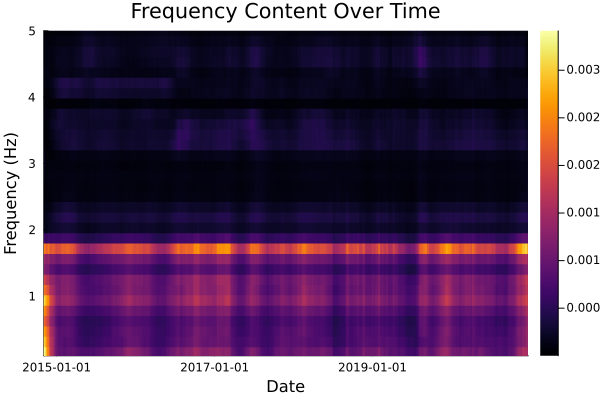

In [35]:
using Plots, DSP

# Given variables
dailystk_corr = dailystk.corr  # Use the actual data from dailystk.corr
a = a  # Use the actual dates from variable 'a'
lags = -100.0:0.025:100.0  # Given lag times

# Parameters for spectrogram analysis
fs = 1 / 0.025  # Sampling frequency (inverse of lag time resolution)
window_length = 256  # Length of each segment for the spectrogram
overlap = round(Int, window_length * 0.5)  # Overlap between segments

# Filter dates before 2021
a_filtered_indices = findall(date -> date < DateTime(2021, 1, 1), a)
a_filtered = a[a_filtered_indices]
dailystk_corr_filtered = dailystk_corr[:, a_filtered_indices]

# Frequency axis for plotting
frequencies = collect(0:fs/window_length:fs/2)
power_matrix = zeros(Float32, length(frequencies), length(a_filtered))

# Compute power spectra for each correlation function over time
for i in 1:length(a_filtered)
    # Extract the i-th correlation function
    signal = dailystk_corr_filtered[:, i]
    
    # Compute the spectrogram
    S = spectrogram(signal, window_length, overlap; window=hanning(window_length), fs=fs)
    
    # Average power over time to get frequency content for the day
    avg_power = mean(S.power, dims=2)
    power_matrix[:, i] = avg_power[:]
end

# Plotting frequency content over time with date on x-axis, frequency on y-axis, and power as color
plot(a_filtered, frequencies, power_matrix, st=:heatmap, xlabel="Date", ylabel="Frequency (Hz)", 
     title="Frequency Content Over Time", color=:inferno, ylim=(0.1, 5))


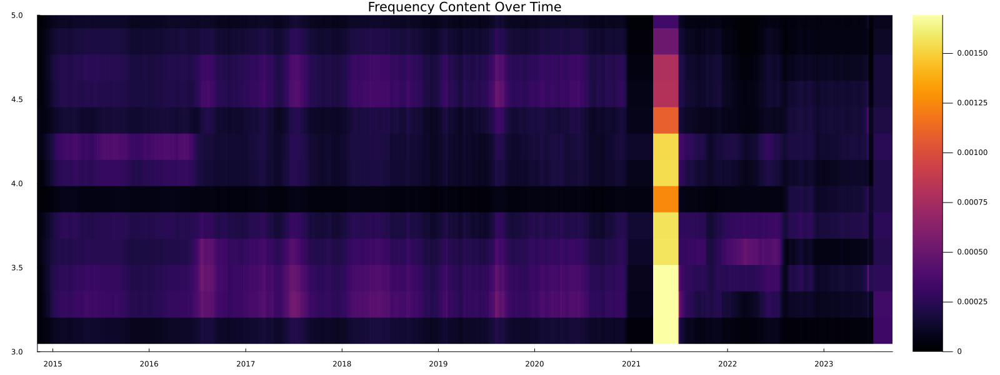

In [76]:
using Plots, DSP

# Given variables
dailystk_corr = dailystk.corr  # Use the actual data from dailystk.corr
a = a  # Use the actual dates from variable 'a'
lags = -100.0:0.025:100.0  # Given lag times

# Parameters for spectrogram analysis
fs = 1 / 0.025  # Sampling frequency (inverse of lag time resolution)
window_length = 256  # Length of each segment for the spectrogram
overlap = round(Int, window_length * 0.5)  # Overlap between segments

# Filter dates before 2021
a_filtered_indices = findall(date -> date < DateTime(2024, 1, 1), a)
a_filtered = a[a_filtered_indices]
dailystk_corr_filtered = dailystk_corr[:, a_filtered_indices]

# Frequency axis for plotting
frequencies = collect(0:fs/window_length:fs/2)
filtered_freq_indices = findall(f -> 3 <= f <= 5, frequencies)
frequencies_filtered = frequencies[filtered_freq_indices]
power_matrix = zeros(Float32, length(frequencies_filtered), length(a_filtered))

# Compute power spectra for each correlation function over time
for i in 1:length(a_filtered)
    # Extract the i-th correlation function
    signal = dailystk_corr_filtered[:, i]
    
    # Compute the spectrogram
    S = spectrogram(signal, window_length, overlap; window=hanning(window_length), fs=fs)
    
    # Average power over time to get frequency content for the day
    avg_power = mean(S.power, dims=2)
    power_matrix[:, i] = avg_power[filtered_freq_indices]
end

# Plotting frequency content over time with date on x-axis, frequency on y-axis, and power as color
xticks_positions = collect(DateTime(y, 1, 1) for y in year(a_filtered[1]):year(a_filtered[end]))
xticks_labels = collect(string(y) for y in year(a_filtered[1]):year(a_filtered[end]))
g=plot(a_filtered, frequencies_filtered, power_matrix, st=:heatmap, xlabel="Date", ylabel="Frequency (Hz)", 
     title="Frequency Content Over Time", color=:inferno, ylim=(3, 5), clims=(0, maximum(power_matrix) * 0.5), size=(1600, 600), xticks=(xticks_positions, xticks_labels))

#savefig(g, "freqcont.png")

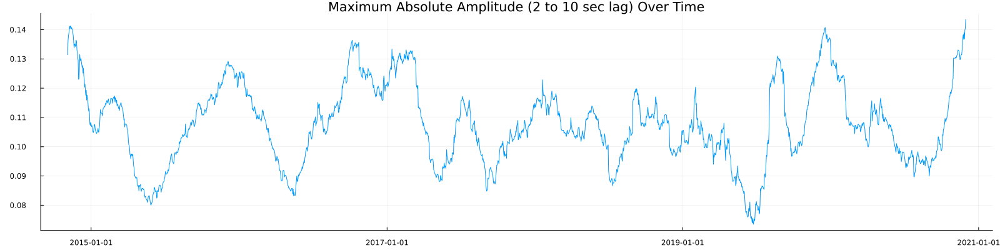

In [63]:
using Plots, DSP

# Given variables
dailystk_corr = dailystk.corr  # Use the actual data from dailystk.corr
a = a  # Use the actual dates from variable 'a'
lags = -100.0:0.025:100.0  # Given lag times

# Parameters for spectrogram analysis
fs = 1 / 0.025  # Sampling frequency (inverse of lag time resolution)
window_length = 256  # Length of each segment for the spectrogram
overlap = round(Int, window_length * 0.5)  # Overlap between segments

# Filter dates before 2021
a_filtered_indices = findall(date -> date < DateTime(2020, 12, 1), a)
a_filtered = a[a_filtered_indices]
dailystk_corr_filtered = dailystk_corr[:, a_filtered_indices]

# Frequency axis for plotting
frequencies = collect(0:fs/window_length:fs/2)
filtered_freq_indices = findall(f -> 0.1 <= f <= 5, frequencies)
frequencies_filtered = frequencies[filtered_freq_indices]
power_matrix = zeros(Float32, length(frequencies_filtered), length(a_filtered))

# Compute power spectra for each correlation function over time
for i in 1:length(a_filtered)
    # Extract the i-th correlation function
    signal = dailystk_corr_filtered[:, i]
    
    # Compute the spectrogram
    S = spectrogram(signal, window_length, overlap; window=hanning(window_length), fs=fs)
    
    # Average power over time to get frequency content for the day
    avg_power = mean(S.power, dims=2)
    power_matrix[:, i] = avg_power[filtered_freq_indices]
end

# Plotting frequency content over time with date on x-axis, frequency on y-axis, and power as color
xticks_positions = collect(DateTime(y, 1, 1) for y in year(a_filtered[1]):year(a_filtered[end]))
xticks_labels = collect(string(y) for y in year(a_filtered[1]):year(a_filtered[end]))
plot(a_filtered, frequencies_filtered, power_matrix, st=:heatmap, xlabel="Date", ylabel="Frequency (Hz)", 
     title="Frequency Content Over Time", color=:inferno, ylim=(3, 5), clims=(0, maximum(power_matrix) * 0.5), size=(1600, 600), xticks=(xticks_positions, xticks_labels))

# Find maximum absolute amplitude in the 2 to 10 sec lag window and plot over time
lag_indices = findall(lag -> -60 <= lag <= -10, lags)
max_amplitudes = [maximum(abs.(dailystk_corr_filtered[lag_indices, i])) for i in 1:length(a_filtered)]

# Plotting maximum amplitude over time
plot(a_filtered, max_amplitudes, xlabel="Date", ylabel="Maximum Absolute Amplitude", 
     title="Maximum Absolute Amplitude (2 to 10 sec lag) Over Time", legend=false, size=(1600, 400))


In [217]:
lags = evenly_spaced(-100, 100, size(dailystk.corr, 1))

# Find the index of the maximum absolute value in allstk.corr
max_index = argmax((allstk.corr))

# Find the corresponding lag value
max_lag = lags[max_index]

println("Index of maximum absolute value: ", max_index)
println("Corresponding lag value: ", max_lag)
max_lag=0

Index of maximum absolute value: CartesianIndex(4002, 1)
Corresponding lag value: 0.025


0

In [19]:
dailystk_corr

8001×3027 Matrix{Float32}:
 0.00049613   0.000527147  0.000543722  …  -0.000328302  -0.000328302
 0.000496275  0.000527718  0.000544179     -0.000343451  -0.000343451
 0.000496035  0.000527956  0.000544264     -0.000356857  -0.000356857
 0.000495248  0.000527674  0.000543816     -0.000368266  -0.000368266
 0.000494098  0.00052692   0.000542997     -0.000379613  -0.000379613
 0.000493273  0.000526212  0.000542493  …  -0.000394152  -0.000394152
 0.000493945  0.000526645  0.000543541     -0.00041428   -0.00041428
 0.000497393  0.000529659  0.000547581     -0.000439142  -0.000439142
 0.000504312  0.000536366  0.000555519     -0.000463577  -0.000463577
 0.000514168  0.000546743  0.000566948     -0.000479527  -0.000479527
 0.000525168  0.000559291  0.000579969  …  -0.000479788  -0.000479788
 0.000535127  0.000571671  0.000592082     -0.000462616  -0.000462616
 0.000542929  0.000582211  0.00060188      -0.000435113  -0.000435113
 ⋮                                      ⋱   ⋮            
 0.000

In [70]:
# Denoise allstk and dailystk and store in the corrdata
mdate = 10
ntau = 10
nsv =7
nsv_to_rm = 0
use_wiener = false

# Estimate of the noise power (adjust based on your data)
noise_power = 0.03  # Example value, adjust as needed

allstk.corr = ncf_denoise(allstk.corr, mdate, ntau, nsv, nsv_to_rm, use_wiener, noise_power);

Starting denoising...
Progress: |██████████████████████████████████████████████████| 100.0% Complete
Denoising completed.


In [71]:
dailystk.corr = ncf_denoise(dailystk.corr, mdate, ntau, nsv, nsv_to_rm, use_wiener, noise_power);

Starting denoising...
Progress: |██████████████████████████████████████████████████| 100.0% Complete
Denoising completed.


In [220]:
using Plots
fig=plot(dailystk,size=(1000, 500),left_margin=20Plots.mm, right_margin=5Plots.mm, bottom_margin=10Plots.mm, dpi=200,xlim=[-10,10],grid=:true)
#savefig(fig, "B1140p1_0p3.png")

In [ ]:
using SeisNoise
using Plots

function plot_corr_heatmap(C::CorrData)
    lags = -C.maxlag:1/C.fs:C.maxlag
    times = Dates.format.(Dates.unix2datetime.(C.t), "yyyy/m/d HH:MM")

    # Create the heatmap plot
    p = heatmap(times,lags,C.corr,
                size=(1000, 600), 
                left_margin=20Plots.mm, 
                right_margin=5Plots.mm, 
                bottom_margin=10Plots.mm, 
                dpi=200, 
                seriescolor=:balance, 
                ytickfontsize=10, 
                xtickfontsize=8,
                xrotation=45,
                xgrid=true,
                ylim=[-5,5],
                grid=:true,
                gridalpha=1.0,
                gridlinewidth=2,
                legend=:false,
                gridcolor=:black,
                framestyle=:grid,)

    # Add vertical lines at x = -1, -2, 0, 1, 2, 3, 4, 5
    vlines = [-3, -4, -2, -1, 0, 1, 2, 3, 4, 5]
    for x_val in vlines
        hline!([x_val], color=:black, linewidth=1)
        vline!([])
    end

    return p
end

# Assuming `CorrData` is a type from SeisNoise
# Use the custom plotting function
ppp = plot_corr_heatmap(dailystk)

# Display the plot
display(ppp)
#savefig(ppp, "HYSB1_35.png")

In [223]:
using CSV
using DataFrames

# Assuming dailystk.corr is a matrix
df_corr = DataFrame(dailystk.corr, :auto)  # Use :auto to generate column names

# Save the DataFrame as a CSV file
CSV.write("dailystk_corr.csv", df_corr)



"dailystk_corr.csv"

In [152]:
using SeisNoise
using Plots

function plot_corr_heatmap(C::CorrData)
    lags = -C.maxlag:1/C.fs:C.maxlag
    times = Dates.format.(Dates.unix2datetime.(C.t), "yyyy/m/d HH:MM")

    # Create the heatmap plot
    p = heatmap(lags, times, C.corr',
                size=(1000, 500), 
                left_margin=20Plots.mm, 
                right_margin=5Plots.mm, 
                bottom_margin=10Plots.mm, 
                dpi=200, 
                seriescolor=:balance, 
                ytickfontsize=10, 
                xtickfontsize=8,
                xlim=[-5,5],
                grid=:true,
                gridalpha=1.0,
                gridlinewidth=2,
                gridcolor=:black,
                framestyle=:grid,)

    # Add vertical lines at x = -1, -2, 0, 1, 2, 3, 4, 5
    vlines = [-10, -2, 0, 2, 10]
    for x_val in vlines
        vline!([x_val], color=:black, linewidth=1)
    end

    return p
end

# Assuming `CorrData` is a type from SeisNoise
# Use the custom plotting function
ppp = plot_corr_heatmap(dailystk)

# Display the plot
display(ppp)


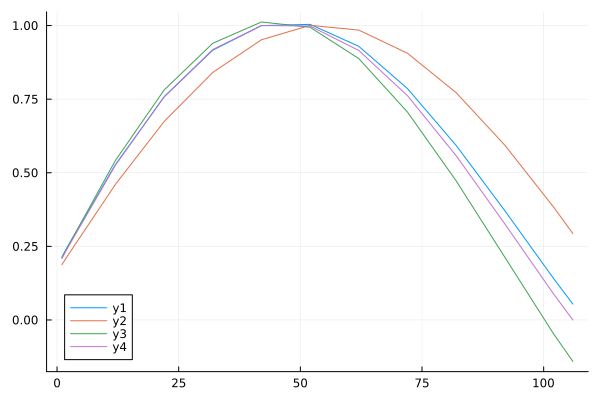

In [525]:
plot((dailystk.corr[4000:4105,100]))
plot!((dailystk.corr[4000:4105,300]))
plot!((dailystk.corr[4000:4105,1000]))#,xlim=[3990,4010])
plot!((allstk.corr[4000:4105]))

In [319]:
using Statistics

# Extract the reference correlation function
reference_corr = dailystk.corr[4000:4005,1]

# Initialize arrays to hold the best lags
best_lags = []
columns = collect(1:659)  # The column indices we are comparing

# Function to compute cross-correlation for all lags
function cross_correlation(x, y)
    n = length(x)
    result = []
    for lag in -(n-1):(n-1)
        if lag < 0
            push!(result, mean(x[1:end+lag] .* y[1-lag:end]))
        else
            push!(result, mean(x[1+lag:end] .* y[1:end-lag]))
        end
    end
    return result, -(n-1):(n-1)  # Return correlation values and lags
end

# Helper function to shift an array based on the best lag
function shift_array(arr, lag)
    if lag > 0
        return vcat(zeros(lag), arr[1:end-lag])  # Shift to the right (positive lag)
    elseif lag < 0
        return vcat(arr[(-lag+1):end], zeros(-lag))  # Shift to the left (negative lag)
    else
        return arr  # No shift if lag is zero
    end
end

# Iterate over every column from 1 to 659 and calculate the best lag
for i in columns
    # Extract the correlation function for the current column
    current_corr = dailystk.corr[4000:4005,i]
    
    # Compute the cross-correlation between the reference and current function
    cross_corr, lags = cross_correlation(reference_corr, current_corr)
    
    # Find the index of the maximum correlation
    max_index = argmax(cross_corr)
    
    # Find the lag with the highest correlation
    best_lag = lags[max_index]
    
    # Store the best lag
    push!(best_lags, best_lag)
    
    # Shift the current column by the best lag
    dailystk.corr[:,i] = shift_array(dailystk.corr[:,i], best_lag)
end

# The dailystk.corr matrix is now corrected based on the best lag of alignment


In [320]:
# Helper function to compute cross-correlation for all lags
function cross_correlation(x, y)
    n = length(x)
    result = []
    for lag in -(n-1):(n-1)
        if lag < 0
            push!(result, mean(x[1:end+lag] .* y[1-lag:end]))
        else
            push!(result, mean(x[1+lag:end] .* y[1:end-lag]))
        end
    end
    return result, -(n-1):(n-1)  # Return correlation values and lags
end


cross_correlation (generic function with 1 method)

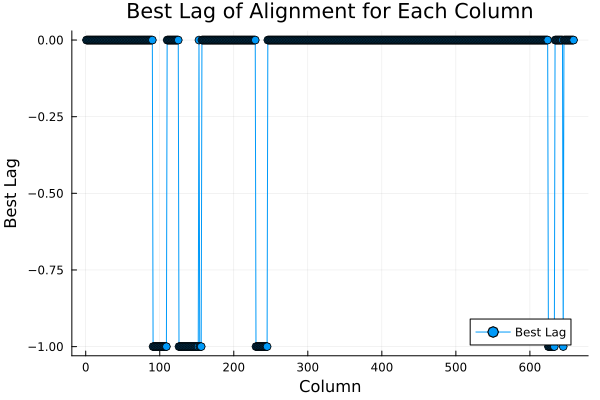

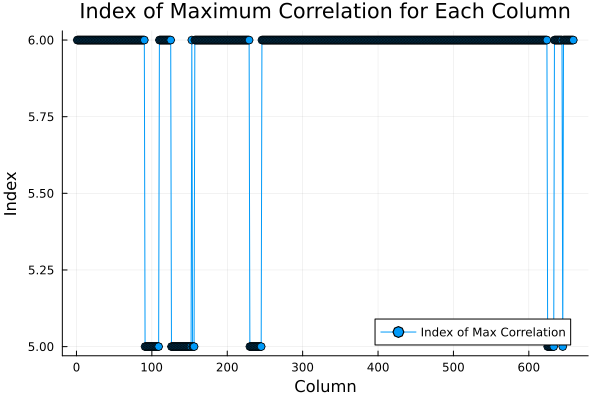

In [321]:
using Statistics
using Plots

# Extract the reference correlation function
reference_corr = dailystk.corr[4000:4005,1]

# Initialize arrays to hold the best lags and indices of maximum correlation
best_lags = []
max_indices = []
columns = collect(1:659)  # The column indices we are comparing

# Function to compute cross-correlation for all lags
function cross_correlation(x, y)
    n = length(x)
    result = []
    for lag in -(n-1):(n-1)
        if lag < 0
            push!(result, mean(x[1:end+lag] .* y[1-lag:end]))
        else
            push!(result, mean(x[1+lag:end] .* y[1:end-lag]))
        end
    end
    return result, -(n-1):(n-1)  # Return correlation values and lags
end

# Iterate over every column from 1 to 659 and calculate the best lag
for i in columns
    # Extract the correlation function for the current column
    current_corr = dailystk.corr[4000:4005,i]
    
    # Compute the cross-correlation between the reference and current function
    cross_corr, lags = cross_correlation(reference_corr, current_corr)
    
    # Find the index of the maximum correlation
    max_index = argmax(cross_corr)
    
    # Find the lag with the highest correlation
    best_lag = lags[max_index]
    
    # Store the best lag and index of maximum correlation
    push!(best_lags, best_lag)
    push!(max_indices, max_index)
end

# Plot the best lag for each column
p1 = plot(columns, best_lags, marker=:o, label="Best Lag", xlabel="Column", ylabel="Best Lag", title="Best Lag of Alignment for Each Column")

# Plot the index of the maximum correlation for each column
p2 = plot(columns, max_indices, marker=:o, label="Index of Max Correlation", xlabel="Column", ylabel="Index", title="Index of Maximum Correlation for Each Column")

# Display both plots
display(p1)
display(p2)


In [28]:
a = Vector{DateTime}(undef, length(dailystk.t))

# Loop to convert unix timestamps to DateTime objects
for i in 1:length(dailystk.t)
    a[i] = unixtimestamp_to_datetime(dailystk.t[i])
end
a[200]

2015-05-22T00:00:00

In [ ]:
using Plots
using DSP
data = allstk.corr
# Assuming `data` is already defined and contains your correlation data
abs_data = abs.(data)

# Compute the analytic signal using the Hilbert transform
analytic_signal = hilbert(abs_data)

# Calculate the envelope of the signal and then square it
squared_envelope = abs.(analytic_signal).^2

# Generate a time vector using LinRange. Adjust according to your data's time domain.
times = LinRange(-100, 100, length(data))

using Plots

# Assumed definitions for 'time', 'squared_envelope', 'dailystk', and 'snr' function
# Define your data and functions here

# Create the first subplot
p1 = plot(times, squared_envelope, label="Squared Envelope", linewidth=2, color=:red, 
          legend=false, yscale=:log10, ylabel="E in arbitrary Units", 
          size=(800, 500), left_margin=20Plots.mm, right_margin=5Plots.mm, 
          bottom_margin=10Plots.mm, dpi=200, xlabel="lag", xticks=-100:20:100, xlim=[-100, 100])
#vline!(p1, [-10, -60, 10, 60])

# Create the second subplot
p2 = plot(times, snr(dailystk), legend=false, ylabel="snr", ylim=[0, 900], xlim=[-100, 100], 
          size=(800, 500), left_margin=20Plots.mm, right_margin=5Plots.mm, 
          bottom_margin=10Plots.mm, dpi=200, xlabel="lag", xticks=-100:20:100)
#vline!(p2, [-60, -10, 60, 10])

# Combine subplots with aligned x-axis
combined_plot = plot(p1, p2, layout = (2, 1), link = :x)

# Display the combined plot
display(combined_plot)
#savefig(combined_plot, "combined_plot E and SNR 1p0 3p0.png")

In [528]:
j = size(dailystk.corr, 2)

1461

## Parallelized Stretching 

In [36]:
using Distributed

# Add processes (if not already added)
if nprocs() == 1  # Only the main process is running
    addprocs(14)  # Adjust the number as needed 7
end

@everywhere begin
    using SharedArrays, HDF5, Plots,SeisNoise, SeisIO, Plots
    using Dates 
    using Plots
    using SeisDvv
    # Ensure all necessary modules are loaded in each worker

    fs = 40.0     # sample frequency
    win_len = 2.0  # sliding window length
    win_step = 5.0 # sliding window step
    tmin = -10.0
    tmax = -1.0
    dmn = -0.05
    dmx = 0.05
end

# Define your data or load it in a way that each worker can access it
# Assuming dailystk.corr is accessible to all workers, or needs to be distributed
j = size(dailystk.corr, 2)
dvt = SharedArray{Float64}(j)
cct = SharedArray{Float64}(j)
cctb = SharedArray{Float64}(j)

@distributed for i = 1:j
    S1 = Array(allstk.corr[:])
    S2 = Array(dailystk.corr[:,i])
    rel_tmin_index = Int(floor((tmin + 100+max_lag) * fs))
    rel_tmax_index = Int(floor((tmax + 100+max_lag) * fs))
    
    window = collect(rel_tmin_index:rel_tmax_index)
    fmin = mnf  # Ensure mnf is defined or loaded
    fmax = mxf  # Ensure mxf is defined or loaded

    function evenly_spaced(a, b, n)
        h = (b - a) / (n - 1)
        collect(a:h:b)
    end

    time = evenly_spaced(-100, 100, size(dailystk.corr, 1))
    time = time.-max_lag

    dvv_ts, cc_ts, cdp_Ts, eps_ts, err_ts, allC_ts = SeisDvv.stretching(S1, S2, time, window, fmin, fmax, dvmin=dmn, dvmax=dmx, ntrial=1000)
    dvt[i] = dvv_ts
    cct[i] = cc_ts
    cctb[i] = cdp_Ts
end

println("Computation completed.")


Computation completed.


In [37]:
dt = map(unix2datetime, dailystk.t);
# Assuming datetime_vector is your 71-element Vector{DateTime} 
# and float_vector is your 71-element Vector{Float64}
datetime_vector = dt;  # fill this with your data
float_vector = dvt;  # fill this with your data
cctfilter = cct;

# Combine the vectors into a named tuple which CSV.File will interpret as a table
data = (DateTime=datetime_vector, Float=float_vector,cct);

# Set the threshold value
threshold = 0.8

# Filter the datetime and float vectors based on the threshold
filtered_indices = cct .>= threshold;
datetime_vector = datetime_vector[filtered_indices];
float_vector = float_vector[filtered_indices];
cctfilter = cct[filtered_indices];

# Calculate the Interquartile Range (IQR)
Q1 = quantile(float_vector, 0.1)#20)
Q3 = quantile(float_vector, 0.9)#80)
IQR = Q3 - Q1

# Calculate the lower and upper bounds to filter the outliers
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Filter the vectors to remove the outliers
dtf = DateTime[]
dvtf = Float64[]
cctf = Float64[]
for i in 1:length(float_vector)
    if float_vector[i] >= lower_bound && float_vector[i] <= upper_bound
        push!(dtf, datetime_vector[i])
        push!(dvtf, float_vector[i])
        push!(cctf, cctfilter[i])
    end
end
# Calculate the mean and standard deviation
mean_value = mean(cct)
std_deviation = std(dvtf)

# Print the results
println("Mean of the float vector: $mean_value")
println("Standard deviation of the float vector: $std_deviation")

# Sample datetime_vector and dvtf
datetime_vector = dtf

# Find the minimum and maximum dates in the datetime_vector
min_date = minimum(datetime_vector)
max_date = maximum(datetime_vector)

# Generate all dates in the date rangeI'
all_dates = collect(min_date:Day(ndaystack):max_date)

# Find the dates that are in all_dates but not in datetime_vector (considering only the date part)
missing_dates = setdiff(all_dates, datetime_vector)

# Assuming dt, dvt, cct, and dailystk are defined
#dt = map(unix2datetime, dailystk.t)
ticks = dtf[1:100:end]
tick = Dates.format.(ticks, "yyyy-mm-dd")

# First subplot
p1 = plot(scatter(dtf, dvtf), seriestype = :line, xticks = (ticks, tick), xrot = -30, ylabel="dv/v %", legend=false)#,ylim=(-0.5, 0.5))
plot!(dtf, dvtf, seriestype = :line, xticks = (ticks, tick), xrot = -30, legend=false)
# For each missing date, add a vertical line to the plot
#for date in missing_dates
#    vline!(p1, [DateTime(date)], linecolor=:red, linewidth=2, linealpha=0.5, label="Missing Date")
#end


# Second subplot
p2 = plot(dtf, cctf, seriestype = :line, ylim = [0.6, 1], label = "cc", xticks = (ticks, tick), xrot = -30, left_margin = 10Plots.mm, ylabel="cc", xlabel="Date", legend=false)
hline!([0.8], label="Threshold", width=2, color=:red) # Adding a horizontal line at y=0.8

# Third subplot
p3 = plot(dailystk,xlim=[-30,30], left_margin = 10Plots.mm)

# The layout now specifies a grid of 3 rows and 1 column and gives the third plot even more vertical space compared to the first two.
l = @layout([a{0.3h}; b{0.2h}; c{0.5h}])

# Combine the plots
final_plot = plot(p1, p2, p3, layout = l, size = (1100, 1000), left_margin = 20Plots.mm, right_margin = 5Plots.mm)

# Save the plot
#savefig(final_plot, "$(d.name)_t$(tmin)-$(tmax)_freq$(mnf)-$(mxf)_stk$(ndaystack)SVD7s.png")

Mean of the float vector: 0.8933607512935963
Standard deviation of the float vector: 0.250154219399454


In [77]:
using Plots

ticks = dtf[1:100:end]
tick = Dates.format.(ticks, "yyyy-mm-dd")
# Your data and plot setup here
# Example: dtf, dvtf, cctf, ticks, tick

# Define a color gradient
my_colormap = :viridis  # You can choose another colormap as needed
# Normalize your cctf values to the range of the colormap
normalized_cctf = cctf

# Add leading spaces to the color bar title to create more space
colorbar_title_with_space = "          cc"  # Adjust the number of spaces as needed

# First plot with colors based on cctf values
p1 = scatter(dtf, dvtf, zcolor=normalized_cctf, cmap=my_colormap, markerstrokewidth=0,
             colorbar=true, colorbar_title=colorbar_title_with_space, seriestype=:scatter, legend=false,
             xticks=(ticks, tick), xrot=-30, ylabel="dv/v %", ylim=(-1,1),#xlim=(DateTime(2016,3,25), DateTime(2016,12,1)),
             size=(1000, 300), left_margin=20Plots.mm, right_margin=10Plots.mm,
             bottom_margin=10Plots.mm, dpi=200)
plot!(dtf, dvtf, legend=false, xticks=(ticks, tick), xrot=-50,size = (1200 , 350),left_margin = 20Plots.mm, right_margin = 10Plots.mm,bottom_margin = 10Plots.mm, dpi=200)

# Display the plotcvh
display(p1)
#savefig(p1, "thedrop3stk.png")
#savefig(p1, "$(d.name)_t$(tmin)-$(tmax)_freq$(mnf)-$(mxf)_stk$(ndaystack)dvvvv.png")
#savefig(p1, "syntheticdvvvvn.png")


LoadError: UndefVarError: dtf not defined

In [ ]:
p2 = plot(dtf, cctf, seriestype = :line, ylim = [0.8, 1.05], label = "cc", xticks = (ticks, tick), xrot = -30, ylabel="cc", xlabel="Date", legend=false,size=(1500, 500),left_margin = 20Plots.mm, right_margin = 10Plots.mm,bottom_margin = 10Plots.mm, dpi=200)
#hline!([0.8], label="Threshold", width=2, color=:red) # Adding a horizontal line at y=0.8
savefig(p2, "thedrop10stkcc.png")

In [39]:
using CSV, DataFrames

# Assuming dvt and cct are already defined as 75-element Vector{Float64}
df = DataFrame(T = dtf, DVT = dvtf, CCT = cctf)

# Save the DataFrame to a CSV file
CSV.write("HYSB1_ZE35n1_10.csv", df)

"HYSB1_ZE35n1_10.csv"

### Original stretching method

In [ ]:
fs=40.0     # sample frequency
win_len=5.0  # sliding window length
win_step=2.5 # sliding window step
j=size(dailystk.corr,2)
dvt=zeros(j)
cct=zeros(j)
cctb=zeros(j)
tmin = 10.0
tmax = 20.0
dmn = -0.05
dmx = 0.05

println("Starting computation...")

for i in 1:j
    S1=Array(allstk.corr[:])
    S2=Array(dailystk.corr[:,i])
    rel_tmin_index = Int(floor((tmin + 100) * fs))
    rel_tmax_index = Int(floor((tmax + 100) * fs))

    window = collect(rel_tmin_index:rel_tmax_index)
    fmin = mnf
    fmax = mxf

    function evenly_spaced(a, b, n)
        h = (b-a)/(n-1)
        collect(a:h:b)
    end

    time=evenly_spaced(-100,100,size(dailystk.corr,1))

    dvv_ts, cc_ts, cdp_Ts, eps_ts, err_ts, allC_ts = SeisDvv.stretching(S1, S2, time, window, fmin, fmax, dvmin=dmn, dvmax=dmx, ntrial=1000);
    dvt[i]=dvv_ts
    cct[i]=cc_ts
    cctb[i]=cdp_Ts

    # Update progress bar
    update_progress_bar(i, 1, j)
end

println("\nComputation completed.")

In [ ]:
using CSV
using DataFrames

# Define the file paths
file_paths = [
    "/home/seismic/AmbientNoiseOOI/src/14_60daystack_3p0to5p0 negativeZE 102svd7.csv",
    "/home/seismic/AmbientNoiseOOI/src/14_60daystack_3p0to5p0 positiveZE 210svd7.csv"
]

# Initialize arrays to hold the weighted dv/v values, the weights, and sum of CCs
weighted_dv_v_values = zeros(210)
sum_ccs = zeros(210)

# Process each file
for file_path in file_paths
    # Read the CSV file
    df = CSV.read(file_path, DataFrame)

    # Calculate the weighted dv/v and accumulate
    weighted_dv_v_values .+= df.DVT .* (df.CCT .^ 2)
    sum_ccs .+= df.CCT .^ 2
end

# Calculate the final dv/v and cc time series
final_dv_v = weighted_dv_v_values ./ sum_ccs
final_cc = sqrt.(sum_ccs) / length(file_paths);

In [ ]:
# Create a new DataFrame to store the time series
timestamps = CSV.read(file_paths[1], DataFrame).T # Assuming all files have the same timestamps
final_time_series = DataFrame(T = timestamps, dv_v = final_dv_v, cc = final_cc)

In [ ]:
# Save the final time series to a CSV file
#CSV.write("final_dv_v_timeseries 0p1 to 0p3.csv", final_time_series)
p1 = plot(scatter(dt, final_time_series.dv_v), seriestype = :line, xticks = (ticks, tick), xrot = -30, ylabel="dv/v %", legend=false,ylim=(-0.1, 0.1),size=(1000, 500))
plot!(dt, final_time_series.dv_v, seriestype = :line, xticks = (ticks, tick), xrot = -30, legend=false)
#println("The final dv/v time series has been saved to 'final_dv_v_timeseries.csv'")

##### averaging correlation function for stretching - only use this if original was not used

In [ ]:
#averaging correlation function
fs=40.0     # sample frequency
win_len=5.0  # sliding window length
win_step=2.5 # sliding window step
j=size(dailystk.corr,2)
dvt=zeros(j)
cct=zeros(j)
cctb=zeros(j)
tmin = 25.
tmax = 60.
dmn = -0.05
dmx = 0.05

time = evenly_spaced(-100, 100, size(allstk.corr, 1))

# Apply averaging to S1
S1_averaged = average_causal_acausal(Array(allstk.corr[:]), time)

for i in 1:j
    S2 = Array(dailystk.corr[:,i])

    # Apply averaging to S2
    S2_averaged = average_causal_acausal(S2, time)

    # Define the window for DV/V calculation
    rel_tmin_index = Int(floor((tmin + 100) * fs))
    rel_tmax_index = Int(floor((tmax + 100) * fs))
    window = collect(rel_tmin_index:rel_tmax_index)

    # DV/V calculation using SeisDvv
    dvv_ts, cc_ts, cdp_Ts, eps_ts, err_ts, allC_ts = SeisDvv.stretching(S1_averaged, S2_averaged, time, window, mnf, mxf, dvmin=dmn, dvmax=dmx, ntrial=1000)

    # Storing results
    dvt[i] = dvv_ts
    cct[i] = cc_ts
    cctb[i] = cdp_Ts
end

In [ ]:
using Plots

# Assuming dtf, dvtf, cctf, ticks, and tick are already defined

# Remove the first and last points from your data
dtf_adj = dtf  # Adjusted dtf without the first and last points
dvtf_adj = dvtf  # Adjusted dvtf without the first and last points
normalized_cctf_adj = normalized_cctf#[2:end-1]  # Adjusted cctf without the first and last points

# Define a color gradient with a new variable name
my_colormap = :viridis  # You can choose another colormap as needed

# First plot with colors based on adjusted cctf values, excluding the first and last points
p1 = scatter(dtf_adj, dvtf_adj, zcolor=normalized_cctf_adj, cmap=my_colormap, markerstrokewidth=0,
             colorbar=true, colorbar_title="cc", seriestype=:scatter, legend=false,
             xticks=(ticks, tick), xrot=-30, ylabel="dv/v %", ylim=(-0.7, 0.7))
plot!(dtf_adj, dvtf_adj, legend=false, xticks=(ticks, tick), xrot=-30, size=(1000, 300),
      left_margin=20Plots.mm, right_margin=5Plots.mm, bottom_margin=10Plots.mm, dpi=200)

# Display the plot
display(p1)

# Save the figure with adjusted filename to reflect changes if needed
savefig(p1, "$(d.name)_t$(tmin)-$(tmax)_freq$(mnf)-$(mxf)_stk$(ndaystack)dvv.png")

In [ ]:
using CSV
using DataFrames
using Dates
using Plots
using Interpolations
using GLM  # Add this for linear regression

# Reads and optionally parses the CSV file
function read_and_optionally_parse(file_path::String)
    df = CSV.read(file_path, DataFrame)
    if eltype(df.T) == String
        df.T = DateTime.(df.T, DateFormat("yyyy-MM-ddTHH:MM:ss"))
    end
    return df
end

# Interpolates and calculates weighted DVT and CC
function interpolate_and_calculate(df1::DataFrame, df2::DataFrame)
    combined_df = vcat(df1, df2)
    unique_timestamps = sort(unique(combined_df.T))
    
    ts_to_num = (ts -> (ts - minimum(unique_timestamps)).value)
    df1_num = ts_to_num.(df1.T)
    df2_num = ts_to_num.(df2.T)
    all_ts_num = ts_to_num.(unique_timestamps)
    
    interp_dvt1 = LinearInterpolation(df1_num, df1.DVT, extrapolation_bc=Line())
    interp_cct1 = LinearInterpolation(df1_num, df1.CCT, extrapolation_bc=Line())
    interp_dvt2 = LinearInterpolation(df2_num, df2.DVT, extrapolation_bc=Line())
    interp_cct2 = LinearInterpolation(df2_num, df2.CCT, extrapolation_bc=Line())
    
    weighted_dvt = ((interp_dvt1(all_ts_num) .* interp_cct1(all_ts_num).^2) + (interp_dvt2(all_ts_num) .* interp_cct2(all_ts_num).^2)) ./ 
                   (interp_cct1(all_ts_num).^2 + interp_cct2(all_ts_num).^2)
    
    updated_cc = sqrt.(interp_cct1(all_ts_num).^2 + interp_cct2(all_ts_num).^2)
    
    return unique_timestamps, weighted_dvt, updated_cc
end

# Plots weighted DVT with CC colors and adds a linear trend line
function plot_weighted_dvt_with_cc_colors(timestamps, weighted_dvt, updated_cc)
    scatter(timestamps, weighted_dvt, marker_z=updated_cc, label="Weighted DVT", color=:viridis, xlabel="Time", ylabel="Weighted DV/V", markersize=4, legend=false, markerstrokewidth=0,
             colorbar=true, colorbar_title="CC", seriestype=:scatter, xrot=-30, ylim=(-0.3, 0.3),
             size=(1000, 300), left_margin=20Plots.mm, right_margin=10Plots.mm,
             bottom_margin=10Plots.mm, dpi=200)
    plot!(timestamps, weighted_dvt, label="Weighted DVT", color=:orange, xlabel="Time")
    
    # Convert timestamps to a numerical format for regression
    ts_numeric = Dates.value.(timestamps - minimum(timestamps))
    
    # Fit a linear model
    lm_model = lm(@formula(y ~ x), DataFrame(x=ts_numeric, y=weighted_dvt))
    
    # Generate predictions for the linear model to plot
    predicted_dvt = predict(lm_model, DataFrame(x=ts_numeric))
    
    # Plot the linear trend line
    plot!(timestamps, predicted_dvt, label="Trend Line", color=:red, linewidth=2)
end


# File paths
file_path_negative = "/home/seismic/AmbientNoiseOOI/src/14_60daystack_3p0to5p0 negativeZE 102svd7.csv"
file_path_positive = "/home/seismic/AmbientNoiseOOI/src/14_60daystack_3p0to5p0 positiveZE 210svd7.csv"

# Read, interpolate, calculate, and plot
df_negative = read_and_optionally_parse(file_path_negative)
df_positive = read_and_optionally_parse(file_path_positive)
timestamps, weighted_dvt, updated_cc = interpolate_and_calculate(df_negative, df_positive)

# Plot with CC-dependent marker colors
plot_weighted_dvt_with_cc_colors(timestamps, weighted_dvt, updated_cc)


In [ ]:
fs=40.0     # sample frequency
win_len=5.0  # sliding window length
win_step=2.5 # sliding window step
j=size(dailystk.corr,2)
dvt=zeros(j)
cct=zeros(j)
cctb=zeros(j)
tmin = -30.0
tmax = -6.0
dmn = -0.05
dmx = 0.05

for i in 1:j
    S1=Array(allstk.corr[:])
    S2=Array(dailystk.corr[:,i])
    rel_tmin_index = Int(floor((tmin + 100) * fs))
    rel_tmax_index = Int(floor((tmax + 100) * fs))

    window = collect(rel_tmin_index:rel_tmax_index)
    fmin = mnf
    fmax = mxf

    function evenly_spaced(a, b, n)
        h = (b-a)/(n-1)
        collect(a:h:b)
    end

    time=evenly_spaced(-100,100,size(dailystk.corr,1))

    dvv_ts, cc_ts, cdp_Ts, eps_ts, err_ts, allC_ts = SeisDvv.stretching(S1, S2, time, window, fmin, fmax, dvmin=dmn, dvmax=dmx, ntrial=1000);
    #dvmin=-0.01, dvmax=0.01
    dvt[i]=dvv_ts
    cct[i]=cc_ts
    cctb[i]=cdp_Ts
    
end

In [394]:
time

time (generic function with 3 methods)

In [ ]:
time=evenly_spaced(-100,100,8001)
plot(time,dailystk.corr[1:8001,81],xlim=[-20,-10])
plot!(time,allstk.corr,size=(1000, 300))

In [431]:
# Load the CSV file directly into a DataFrame, no header assumed
df = CSV.read("/home/seismic/wmsan/ww3-source-maps/notebooks/rayleigh_waves/corr_daily_1stk.csv", DataFrame; header=false)

# Extract the first column as time data
time_data = df[:, 1]
time_data=time_data[2:end]
unix_times = datetime2unix.(DateTime.(time_data, date_format))
# Extract the rest of the columns as the correlation matrix
corr_matrix = Matrix(df[2:end, 2:end])

dif = CSV.read("/home/seismic/wmsan/ww3-source-maps/notebooks/rayleigh_waves/time_data.csv", DataFrame; header=true)
# Extract the 'Time' column as lagtime
lagtime = dif[:, "Time"]
# Logical indexing
idx = (lagtime .>= -100) .& (lagtime .<= 100)

# Extract submatrix
corr_submatrix = corr_matrix[:, idx]
lagtime_sub=lagtime[idx]
corr_submatrix=reverse(corr_submatrix, dims=2)'

799×1461 adjoint(::Matrix{Float64}) with eltype Float64:
 -0.00258311   -0.00848775   -0.000286274  …   0.00520504   -0.000728469
 -0.00135391   -0.00757379    0.00058233       0.00542105   -0.00248545
  0.000104376  -0.00552912    0.00131869       0.00528676   -0.00414687
  0.00167733   -0.00261157    0.00185224       0.00479566   -0.00561989
  0.00322981    0.000788739   0.00214237       0.00396503   -0.0068203
  0.0046188     0.00420419    0.00218009   …   0.00283563   -0.00767748
  0.00570779    0.0071568     0.00198536       0.00146986   -0.00813858
  0.00638112    0.00922739    0.00160102      -5.15853e-5   -0.00817176
  0.00655679    0.0101164     0.00108468      -0.00163444   -0.00776828
  0.00619626    0.00968701    0.000499707     -0.00317665   -0.00694321
  0.00531019    0.00798478   -9.30855e-5   …  -0.00457489   -0.00573487
  0.00395918    0.00523019   -0.000641962     -0.00573133   -0.00420297
  0.00224953    0.00178653   -0.00110805      -0.00656041   -0.00242541
  ⋮    

In [432]:
using Pkg
# Pkg.add("Interpolations")  # Uncomment this line if Interpolations is not already installed
using Interpolations

# Assuming lagtime_sub and corr_submatrix are already defined
# lagtime_sub: Vector of original lag values (~ -99.76 to 99.76)
# corr_submatrix: 799×1432 Matrix{Float64}

# Create the new lag vector with 8001 points ranging from -100 to 100
lags = range(-100, 100, length=8001)

# Initialize the interpolated matrix with zeros (using Float32 for memory efficiency)
corr_interpolated = zeros(Float32, length(lags), size(corr_submatrix, 2))

# Loop over each column (date) and interpolate with extrapolation
for j in 1:size(corr_submatrix, 2)
    # Create a linear interpolation object for the current column
    itp = interpolate((lagtime_sub,), corr_submatrix[:, j], Gridded(Linear()))
    
    # Create an extrapolation object using linear extrapolation
    eitp = extrapolate(itp, Line())

    # Evaluate the interpolation at the new lag points
    corr_interpolated[:, j] = eitp.(lags)
end
#lags = evenly_spaced(-100, 100, size(dailystk.corr, 1))

8001-element Vector{Float64}:
 -100.0
  -99.975
  -99.95
  -99.925
  -99.9
  -99.875
  -99.85
  -99.825
  -99.8
  -99.775
  -99.75
  -99.725
  -99.7
    ⋮
   99.725
   99.75
   99.775
   99.8
   99.825
   99.85
   99.875
   99.9
   99.925
   99.95
   99.975
  100.0

In [433]:
d.t=unix_times
d.corr=corr_interpolated

8001×1461 Matrix{Float32}:
 -0.00374402  -0.00935093  -0.00110662   …   0.00500103   0.000930898
 -0.00362112  -0.00925955  -0.00101977       0.00502263   0.000755225
 -0.00349822  -0.00916817  -0.000932926      0.00504422   0.000579552
 -0.00337531  -0.00907678  -0.000846077      0.00506582   0.000403878
 -0.00325241  -0.0089854   -0.000759229      0.00508742   0.000228205
 -0.00312951  -0.00889402  -0.000672381  …   0.00510902   5.25317f-5
 -0.0030066   -0.00880263  -0.000585532      0.00513062  -0.000123142
 -0.0028837   -0.00871125  -0.000498684      0.00515221  -0.000298815
 -0.0027608   -0.00861987  -0.000411836      0.00517381  -0.000474488
 -0.00263789  -0.00852848  -0.000324987      0.00519541  -0.000650162
 -0.00251499  -0.0084371   -0.000238139  …   0.00521701  -0.000825835
 -0.00239209  -0.00834571  -0.000151291      0.00523861  -0.00100151
 -0.00226919  -0.00825433  -6.44423f-5       0.0052602   -0.00117718
  ⋮                                      ⋱                ⋮
  0.00

In [434]:
d

CorrData with 1461 Corrs
      NAME: "OO.HYSB1..BHZ.OO.HYSB1..BHN"      
        ID: "2014-11-04"                       
       LOC: 0.0 N, 0.0 E, 0.0 m
      COMP: "ZN"                               
   ROTATED: false                              
 CORR_TYPE: "CC"                               
        FS: 40.0
      GAIN: 1.0
   FREQMIN: 0.01
   FREQMAX: 10.0
    CC_LEN: 1800.0
   CC_STEP: 450.0
  WHITENED: true                               
 TIME_NORM: ""                                 
      RESP: a0 1.0, f0 1.0, 1z, 1p
      MISC: 0 entries                          
     NOTES: 10 entries                         
      DIST: 0.0
       AZI: 0.0
       BAZ: 0.0
    MAXLAG: 100.0
         T: 2015-01-01T00:00:00                …
      CORR: 8001×1461 Matrix{Float32}          


In [435]:
save_corr(d, "/home/seismic/wmsan/ww3-source-maps/notebooks/rayleigh_waves/")

"/home/seismic/wmsan/ww3-source-maps/notebooks/rayleigh_waves/OO.HYSB1..BHZ.OO.HYSB1..BHN.jld2"

In [446]:
plot(d,size=(1000, 500),left_margin=20Plots.mm, right_margin=5Plots.mm, bottom_margin=10Plots.mm, dpi=200,xlim=[-60,60])